# Lab 02

In [1]:
import numpy as np 
import pandas as pd
import cv2 
from matplotlib import pyplot as plt 
from pylab import imread
from skimage.color import rgb2gray

C:\Users\PC\anaconda3\Lib\site-packages\paramiko\transport.py:219: CryptographyDeprecationWarning: Blowfish has been deprecated
  "class": algorithms.Blowfish,


In [2]:
# Xử lý đường dẫn
import os
os.chdir('D:/dai hoc/năm 3/HK1/DIP/lab02/image')

### Hàm show ảnh

In [3]:
def imshows(ImageData, LabelData, rows, cols, gridType = False):
  # Convert ImageData and LabelData to List
  from matplotlib import pyplot as plt
  ImageArray = list(ImageData)
  LabelArray = list(LabelData)
  if(rows == 1 & cols == 1):
    fig = plt.figure(figsize=(20,20))
  else:
    fig = plt.figure(figsize=(cols*8,rows*5))
        
  for i in range(1, cols * rows + 1):
      fig.add_subplot(rows, cols, i)
      image = ImageArray[i - 1]
      # Nếu số kênh màu nhỏ hơn 3 thì ta trình chiếu ảnh đen trắng
      # ngược lại thì trình chiếu ảnh màu
      if (len(image.shape) < 3):
          plt.imshow(image, plt.cm.gray)
          plt.grid(gridType)
      else:
          plt.imshow(image)
          plt.grid(gridType)
      plt.title(LabelArray[i - 1])
  plt.show()

def ShowThreeImages(IM1, IM2, IM3):
    imshows([IM1, IM2, IM3], ["Ảnh 1","Ảnh 2", "Ảnh 3"], 1, 3)
def ShowTwoImages(IM1, IM2):
    imshows([IM1, IM2], ["Ảnh 1","Ảnh 2"], 1, 2)
def ShowOneImage(IM):
    imshows([IM], ["Ảnh"], 1, 1)
def ShowListImages(listImage, row, col):
    listCaption = []
    for i in range(len(listImage)):
        listCaption.append(str(i))
    imshows(listImage,listCaption,row,col)

## Bài 1

### Đọc ảnh và tạo ảnh xám

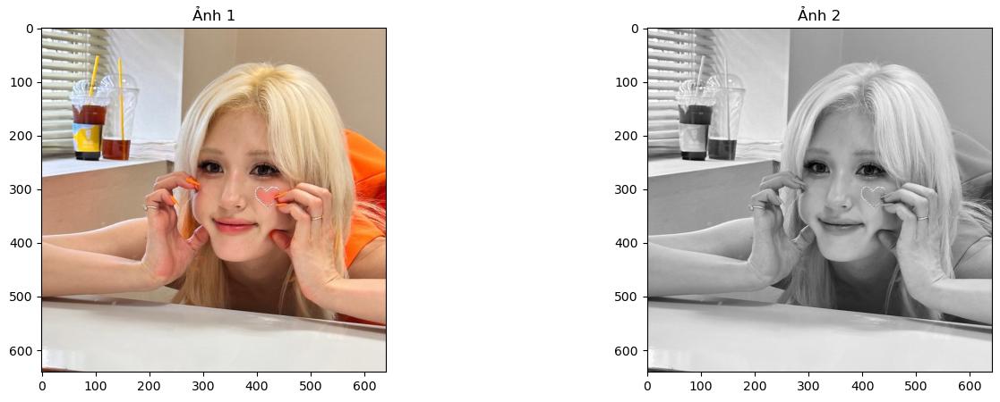

In [4]:
# Read Image 
image_color = imread("somi.jpg")
# Convert Image into Gray: Chuyển thành ảnh xám
image_gray = cv2.cvtColor(image_color, cv2.COLOR_RGB2GRAY)

# Display Image: Hiển thị ảnh
ShowTwoImages(image_color, image_gray)

### Viết function cho biết thông tin của bức ảnh : Ảnh màu hay ảnh xám và giá trị min max tương ứng với từng kênh màu


In [5]:
def info_color_image(Image):
    Image = image_color.copy()
    Width = Image.shape[1]
    Height = Image.shape[0]
    Channel = len(Image.shape)
    print("Width: ", Width, " Height: ", Height, " Channel: ", Channel)

    IM = image_color.copy
    if(Channel == 2):
        print("Min Intensity: ", Image.min(), " Max Intensity: ", Image.max())
    else:
        print("Red - Min Intensity: ", Image[:,:,0].min(), " Max Intensity: ", Image[:,:,0].max())
        print("Green - Min Intensity: ", Image[:,:,1].min(), " Max Intensity: ", Image[:,:,1].max())
        print("Blue - Min Intensity: ", Image[:,:,2].min(), " Max Intensity: ", Image[:,:,2].max())
info_color_image(image_color)

Width:  641  Height:  641  Channel:  3
Red - Min Intensity:  0  Max Intensity:  255
Green - Min Intensity:  0  Max Intensity:  255
Blue - Min Intensity:  0  Max Intensity:  255


In [6]:
def info_gray_image(Image):
    # Show Information of Gray Image
    Image = image_gray.copy()
    Width = Image.shape[1]
    Height = Image.shape[0]
    Channel = len(Image.shape)
    print("Width : ", Width, " Height : ", Height, " Channel : ", Channel)

    IM = image_color.copy
    if(Channel == 2):
        print("Min Intensity: ", Image.min(), " Max Intensity: ", Image.max())
    else:
        print("Red - Min Intensity: ", Image[:,:,0].min(), " Max Intensity: ", Image[:,:,0].max())
        print("Green - Min Intensity: ", Image[:,:,1].min(), " Max Intensity: ", Image[:,:,1].max())
        print("Blue - Min Intensity: ", Image[:,:,2].min(), " Max Intensity: ", Image[:,:,2].max())
info_gray_image(image_gray)

Width :  641  Height :  641  Channel :  2
Min Intensity:  0  Max Intensity:  255


### Hàm biến đổi ảnh thành dãy bit

In [7]:
def intToBitArray(img) :
    row ,col = img.shape
    list = []
    for i in range(row):
        for j in range(col):
             list.append (np.binary_repr( img[i][j] ,width=8  ) )
    return list #the binary_repr() fucntion returns binary values but in string 
                #, not integer, which has it's own perk as you will notice 
def bitplane(bitImgVal , img1D ):
    bitList = [  int(   i[bitImgVal]  )    for i in img1D]
    return bitList
def GetBitImage(index, image2D):
    ImageIn1D = intToBitArray(image2D)
    Imagebit = np.array( bitplane(index, ImageIn1D ) )
    Imagebit = np.reshape(Imagebit , image2D.shape )
    return Imagebit
def GetAllBitImage(image2D):
    image2D_Bit = list()
    for i in range(8):
        image2D_Bit.append(GetBitImage(i, image2D))
    return image2D_Bit

### Hiển thị 24 bức ảnh theo bit của từng kênh màu R, G, B (mỗi kênh 8 ảnh x 3 kênh = 24 ảnh bit)

#### Kênh màu R

List have  8  images


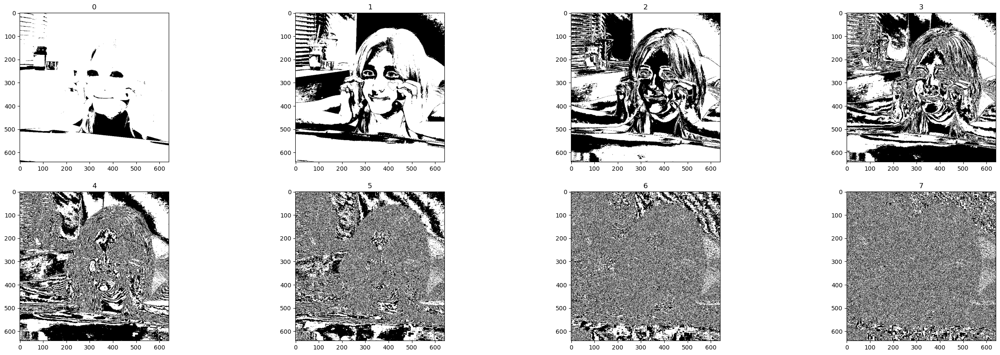

In [8]:
image2D_Bit_R = GetAllBitImage(image_color[:,:,0])
print("List have ", len(image2D_Bit_R), " images")
ShowListImages(image2D_Bit_R, 2, 4)

#### Kênh màu G

List have  8  images


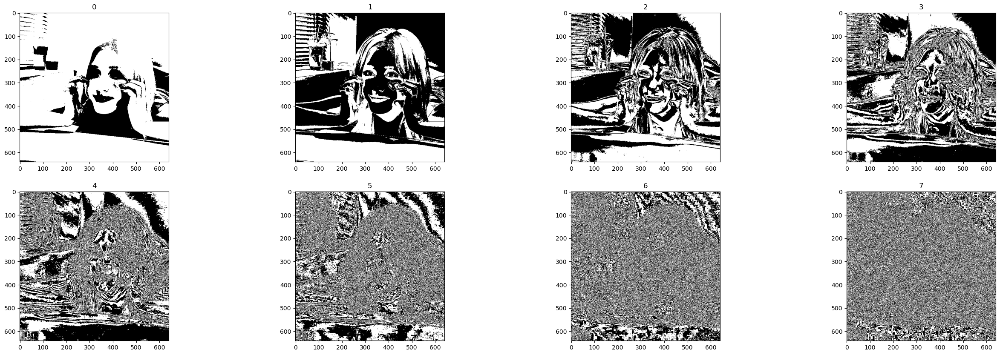

In [9]:
image2D_Bit_G = GetAllBitImage(image_color[:,:,1])
print("List have ", len(image2D_Bit_G), " images")
ShowListImages(image2D_Bit_G, 2, 4)

#### Kênh màu B

List have  8  images


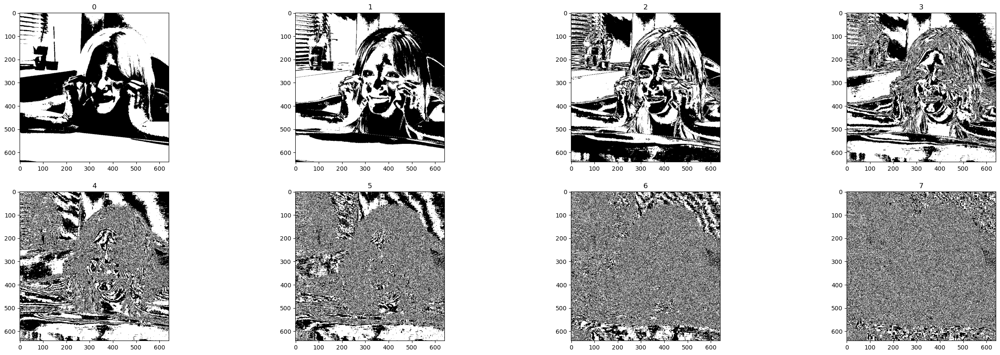

In [10]:
image2D_Bit_B = GetAllBitImage(image_color[:,:,2])
print("List have ", len(image2D_Bit_G), " images")
ShowListImages(image2D_Bit_B, 2, 4)

### Cho biết trong 24 ảnh bit theo kênh R, G, B có ảnh nào có thể dùng để trích xuất đối tượng hay không. Nếu có thì hiển thị ảnh bit đó ra


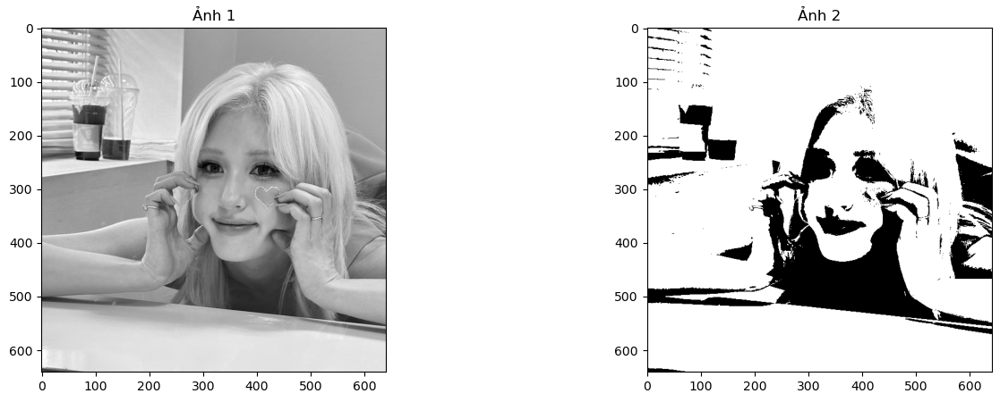

In [11]:
CellMask01 = image2D_Bit_G[0]
ShowTwoImages(image_gray, CellMask01)

### Hiển thị 24 bức ảnh theo bit của từng kênh màu H, S, V

#### Kênh màu Hue

List have  8  images


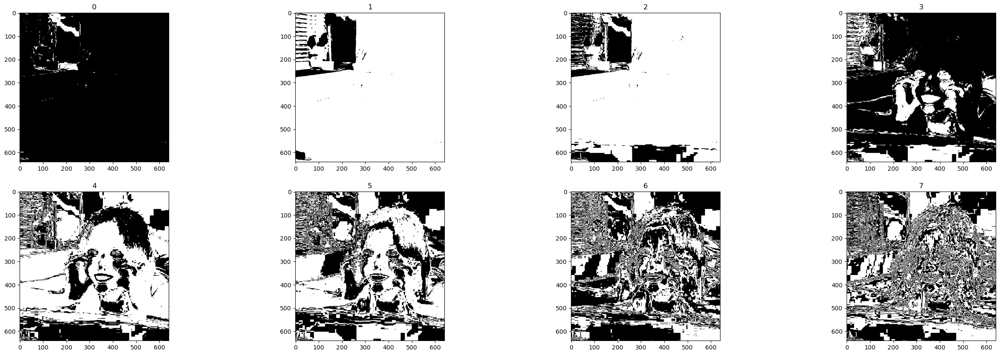

In [12]:
img_hsv = cv2.cvtColor(image_color, cv2.COLOR_BGR2HSV)

image2D_Bit_hsv_H = GetAllBitImage(img_hsv[:,:,0])
print("List have ", len(image2D_Bit_hsv_H), " images")
ShowListImages(image2D_Bit_hsv_H, 2, 4)

#### Kênh màu Saturation

List have  8  images


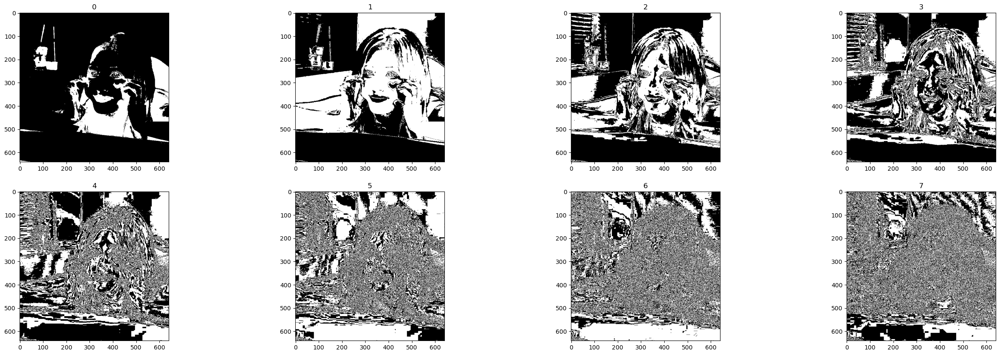

In [13]:
image2D_Bit_hsv_S = GetAllBitImage(img_hsv[:,:,1])
print("List have ", len(image2D_Bit_hsv_S), " images")
ShowListImages(image2D_Bit_hsv_S, 2, 4)

#### Kênh màu value

List have  8  images


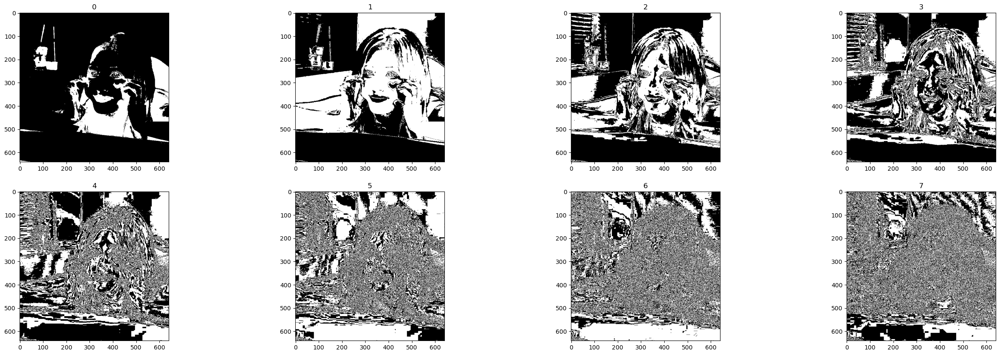

In [14]:
image2D_Bit_hsv_V = GetAllBitImage(img_hsv[:,:,2])
print("List have ", len(image2D_Bit_hsv_S), " images")
ShowListImages(image2D_Bit_hsv_S, 2, 4)

### Cho biết trong 24 ảnh bit theo kênh H, S, V có ảnh nào có thể dùng để trích xuất đối tượng hay không. Nếu có thì hiển thị ảnh bit đó ra


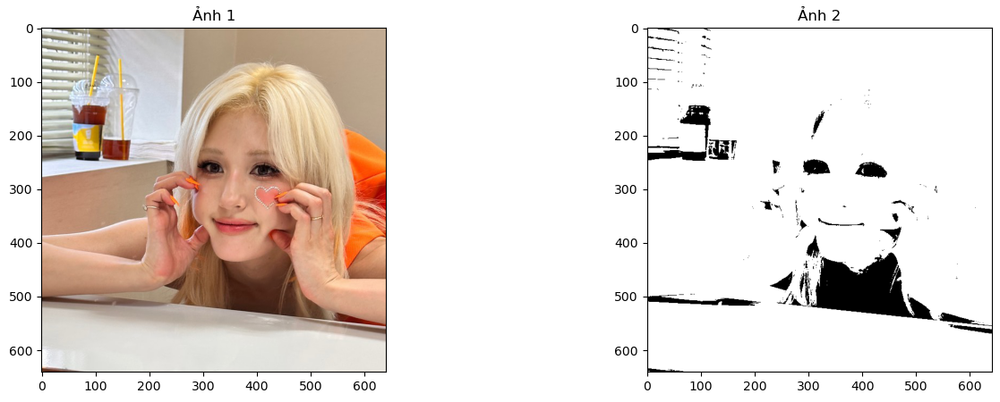

In [15]:
CellMask02 = image2D_Bit_hsv_V[0]
ShowTwoImages(image_color,CellMask02)

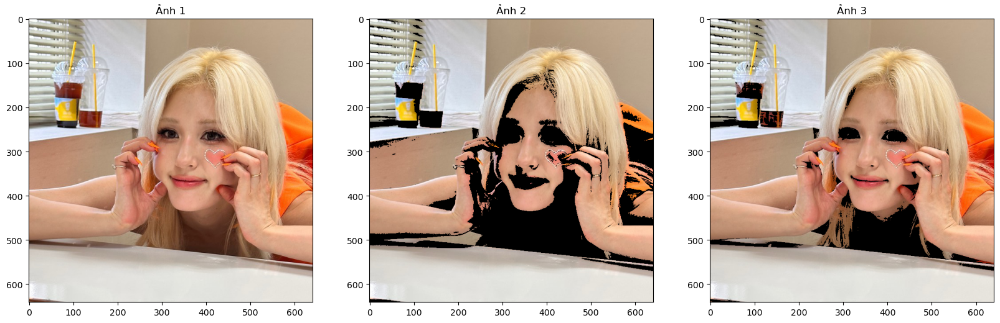

In [16]:
def SegmentColorImageByMask(IM, Mask):
    Mask = Mask.astype(np.uint8)
    result = cv2.bitwise_and(IM, IM, mask = Mask)
    return result
CellMask01_rgb = SegmentColorImageByMask(image_color, CellMask01)
CellMask02_rgb = SegmentColorImageByMask(image_color, CellMask02)
ShowThreeImages(image_color, CellMask01_rgb, CellMask02_rgb)

## Bài 2 

### Viết 1 function input ảnh màu và xuất ảnh chân dung xám và chân dùng màu của ảnh đó 


In [17]:
from skimage.transform import rescale, resize
def colorToGray(image):
  img = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
  img_rescaled_05 = rescale(img, 0.5, anti_aliasing=False)
  print("Rescaled Size 0.5 :", img_rescaled_05.shape)
  ShowTwoImages(image, img_rescaled_05)

Rescaled Size 0.5 : (442, 368)


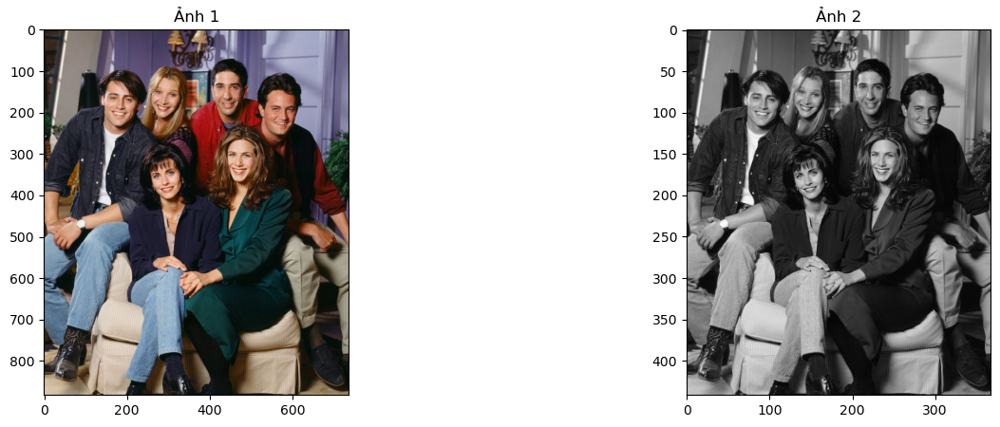

In [18]:
image_2 = imread('friends.jfif')
colorToGray(image_2)


### Tìm chọn range màu lower và upper để trích xuất được các khuôn mặt trong ảnh màu 


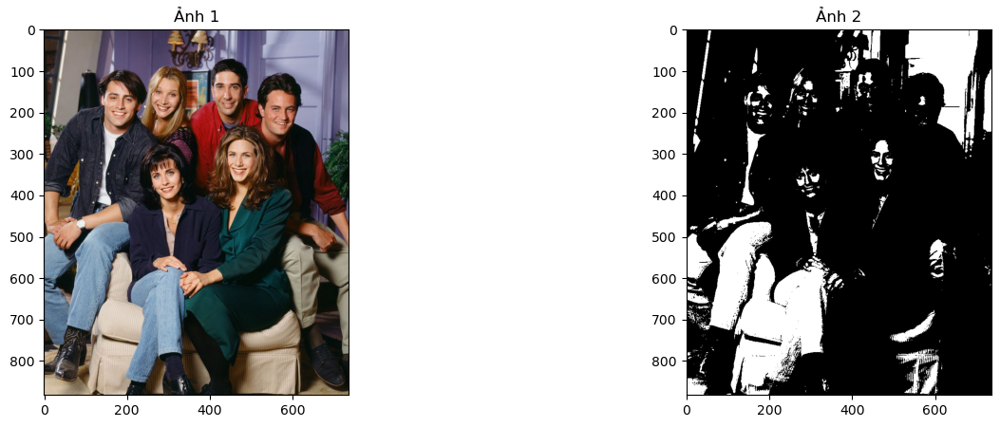

In [19]:
lower = np.array([0,0,150])
upper = np.array([255,255,255])
CellMask02 = cv2.inRange(image_2, lower, upper)
ShowTwoImages(image_2, CellMask02)

## Bài 3

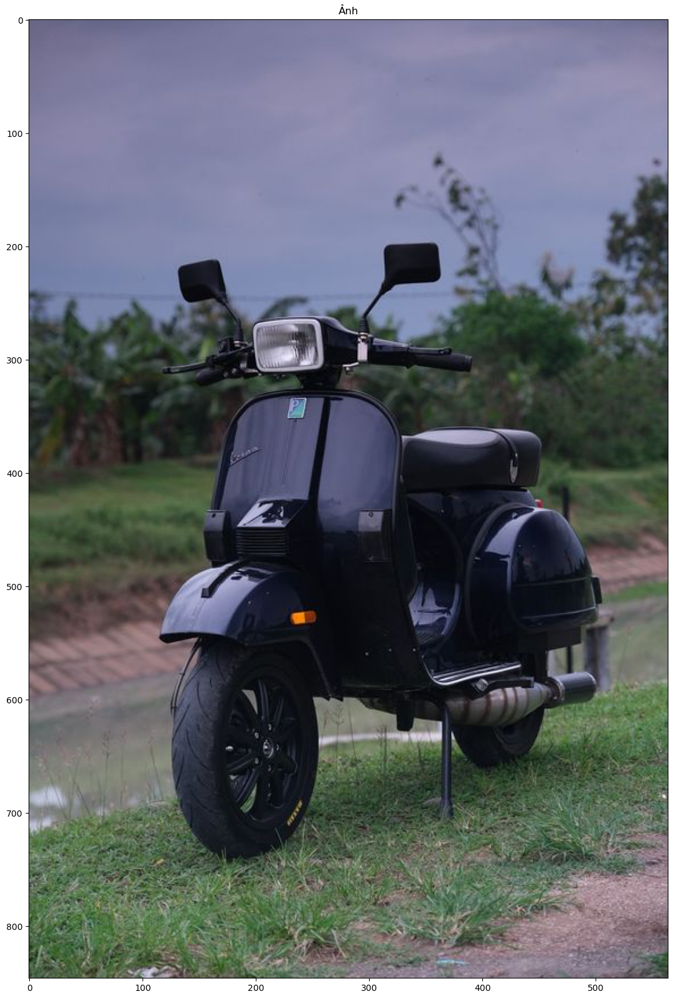

In [20]:
image_3 = imread('vespa.jpg')
ShowOneImage(image_3)

### Xuất ảnh xoay các góc 30, 45, 60 độ

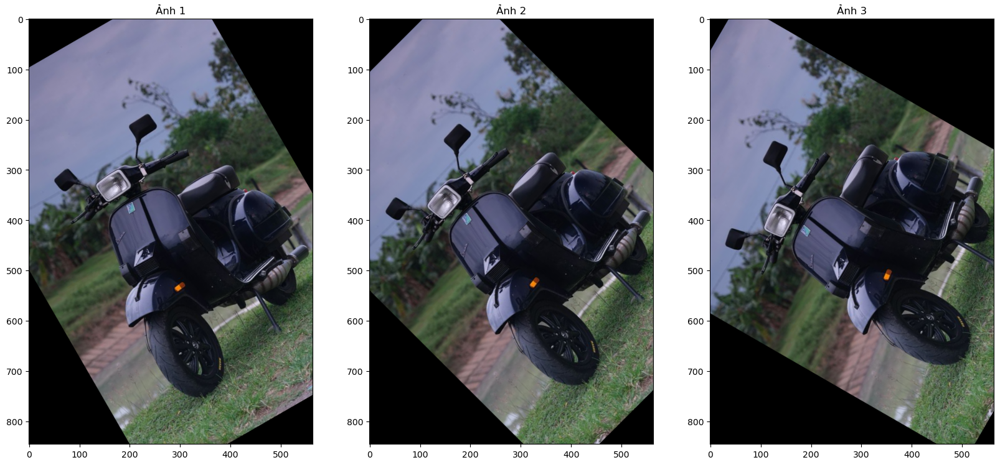

In [21]:
from skimage.transform import rotate
img_30 = rotate(image_3, 30)
img_45 = rotate(image_3, 45)
img_60 = rotate(image_3, 60)
ShowThreeImages(img_30,img_45,img_60)

### Xuất ảnh đối xứng qua trục hoành và trục tung đi qua tâm ảnh

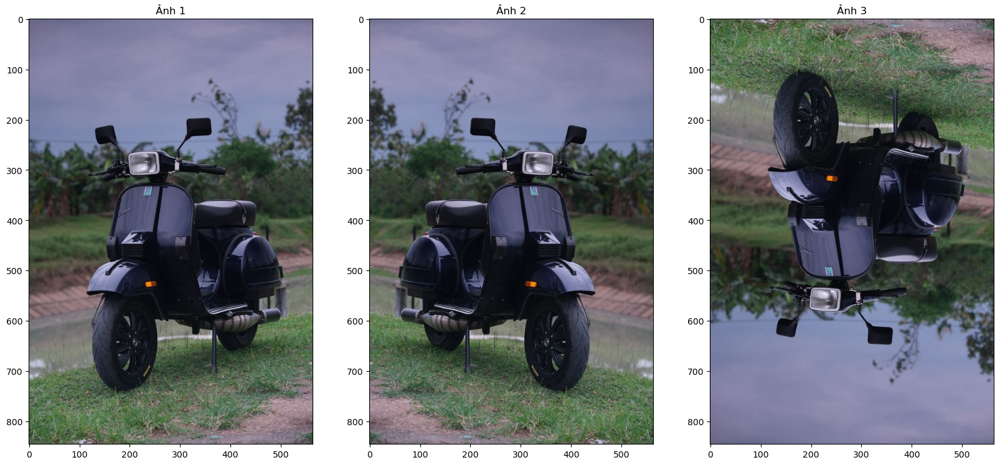

In [22]:
img_vertical_flip = image_3[::-1,:] # trục tung
img_horizontal_flip = image_3[:,::-1] #trục hoành
ShowThreeImages(image_3, img_horizontal_flip, img_vertical_flip)

### Xuất ảnh inversion

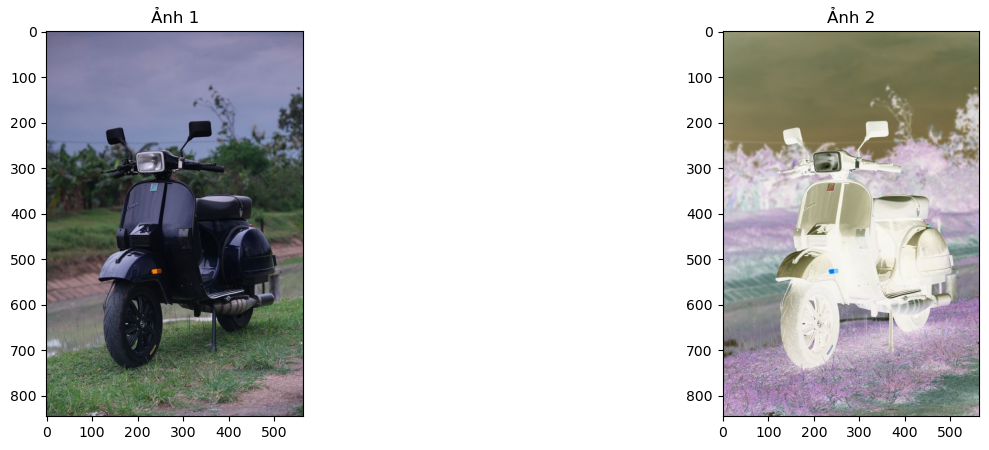

In [23]:
from skimage import util
image_inversion = util.invert(image_3)
ShowTwoImages(image_3, image_inversion)

### Xuất ảnh enhance contrast

14.0 174.0


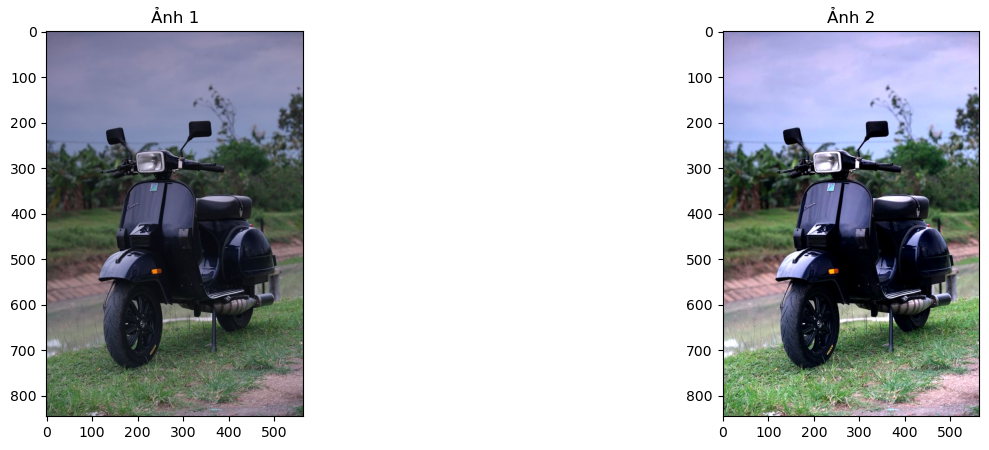

In [24]:
from skimage import exposure
v_min, v_max = np.percentile(image_3,(5,95))
enhance_contrast = exposure.rescale_intensity(image_3, in_range=(v_min,v_max))
print(v_min,v_max)
ShowTwoImages(image_3,enhance_contrast)

### Xuất ảnh gamma và log enhancement

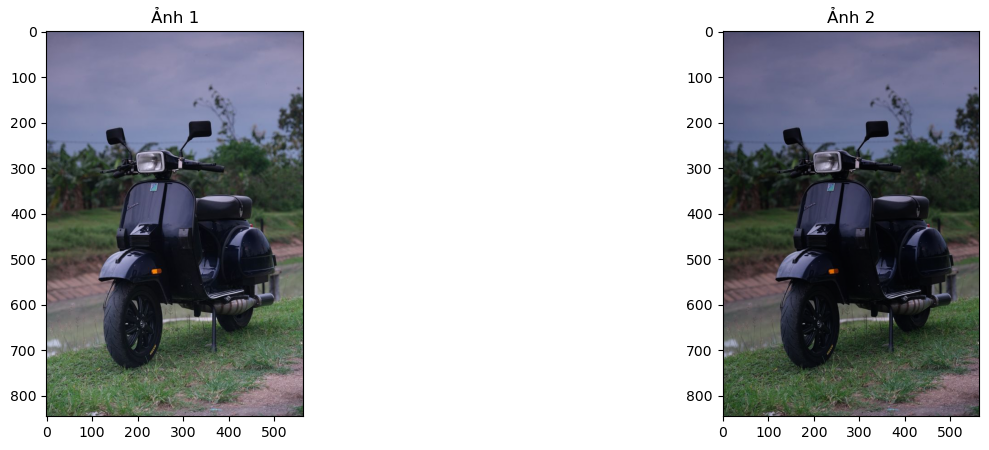

In [25]:
image_gamma = exposure.adjust_gamma(image_3, gamma =1.2, gain = 0.9)
ShowTwoImages(image_3, image_gamma)

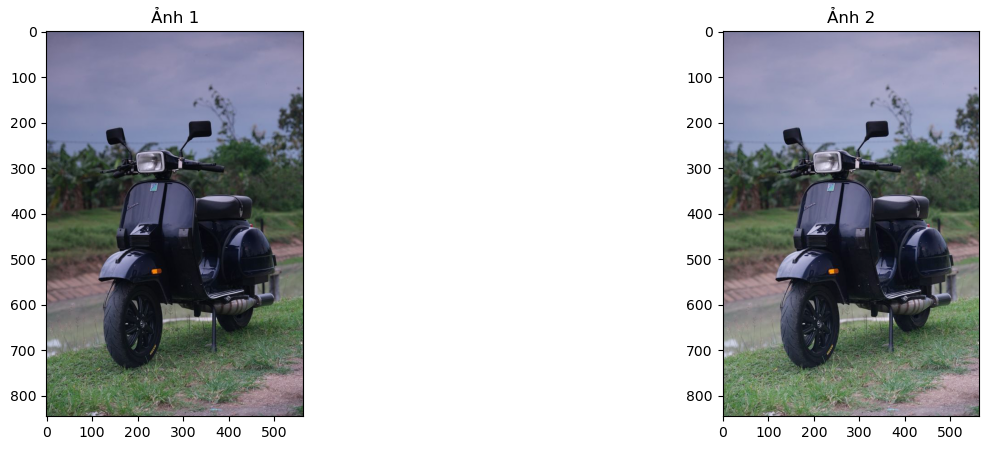

In [26]:
image_log = exposure.adjust_log(image_3)
ShowTwoImages(image_3,image_log)